# SQuAD-Multitask-QuestionAnswer-Generation

In [44]:
!nvidia-smi

Tue Mar  5 03:16:56 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   69C    P0              29W /  70W |   1265MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
import sys
IN_COLAB = 'google.colab' in sys.modules
RUN_TRAINING_CELLS = IN_COLAB

EXPERIMENT_NAME = 'Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/'
DRIVE_FOLDER_LOCATION = '/content/drive/My Drive/QG-Colab/Github/' + EXPERIMENT_NAME

In [2]:
# Mounting google drive
if IN_COLAB:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## Environment setup
Setting up Google drive as working directory and installing packages.

In [3]:
# Using my own Google Drive during the experiment to save all checkpoints and training logs.

if IN_COLAB:
    # Adapted from:  https://robertbrucecarter.com/writing/2020/06/setting-your-working-directory-to-google-drive-in-a-colab-notebook/
    import os

    def create_and_set_working_directory(path: str):
        # check if your project folder exists. if not, it will be created.
        if os.path.isdir(path) == False:
          os.makedirs(path)
          print(path + ' did not exist but was created.')

        # change the OS to use your project folder as the working directory
        os.chdir(path)

        print('Working directory changed to: \n' + path)

    create_and_set_working_directory(DRIVE_FOLDER_LOCATION)
    !pwd

Working directory changed to: 
/content/drive/My Drive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/
/content/drive/My Drive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation


In [4]:
# Install packages
if IN_COLAB:
    !pip install --quiet transformers
    !pip install --quiet pytorch-lightning
    !pip install --quiet tokenizers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 801.6/801.6 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.4/840.4 kB 31.6 MB/s eta 0:00:00


In [ ]:
# import pandas as pd

# # Creating a Pandas DataFrame
# data = {'Name': ['Alice', 'Bob', 'Charlie'],
#         'Age': [25, 30, 22],
#         'City': ['New York', 'San Francisco', 'Los Angeles']}

# df = pd.DataFrame(data)

# # Displaying the DataFrame
# print("Original DataFrame:")
# print(df)

# # Adding a new column
# df['Salary'] = [50000, 60000, 45000]

# # Grouping by city and calculating average age
# average_age_by_city = df.groupby('City')['Age'].mean()

# print("\nDataFrame with Salary column:")
# print(df)
# print("\nAverage Age by City:")
# print(average_age_by_city)


In [5]:
# Import packages
from typing import List, Dict
import tqdm.notebook as tq
from tqdm.notebook import tqdm
import json
import pandas as pd
import numpy as np

import torch
from pathlib import Path
from torch.utils.data import Dataset, DataLoader
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from sklearn.model_selection import train_test_split
from transformers import (
    AdamW,
    T5ForConditionalGeneration,
    T5TokenizerFast as T5Tokenizer
    )

In [6]:
# For reproducibility
pl.seed_everything(42)

INFO:lightning_fabric.utilities.seed:Seed set to 42


42

## Dataset
Using the NQG paper datasplit of the SQuAD v1 dataset.

### Squad
Reading a version of the SQuAD dataset where the there is a row for each question in the dataset.

In [ ]:
# Download squad files
if IN_COLAB:
    !gdown --id 1bJylzAN7ocPTXp_ow-nLE4-hej6c68Vy #train_df.csv
    !gdown --id 1hNJMOTVVKB--btCf3BLPc3frkcppw6fB #dev_df.csv

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:138: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1bJylzAN7ocPTXp_ow-nLE4-hej6c68Vy
To: /content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/train_df.csv
100% 90.0M/90.0M [00:01<00:00, 47.2MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:138: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1hNJMOTVVKB--btCf3BLPc3frkcppw6fB
To: /content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/dev_df.csv
100% 11.2M/11.2M [00:00<00:00, 30.7MB/s]


In [7]:
squad_train_df = pd.read_csv('train_df.csv') # Reads the CSV file 'train_df.csv' into a pandas DataFrame named squad_train_df
print(squad_train_df.shape) #  Prints the shape of the DataFrame, which is the number of rows and columns. The output will look
                            # like (rows, columns)

squad_train_df.head() # Prints the first few rows of the DataFrame. The head() function is used to display the initial rows of
                      # the DataFrame. The default is the first 5 rows, but you can specify the number of rows you want to display
                      # by passing a parameter to head(n)

(87599, 6)


,question,context_para,context_sent,answer_text,answer_start,answer_end
0,To whom did the Virgin Mary allegedly appear i...,"Architecturally, the school has a Catholic cha...","It is a replica of the grotto at Lourdes, Fran...",Saint Bernadette Soubirous,515,541
1,What is in front of the Notre Dame Main Building?,"Architecturally, the school has a Catholic cha...",Immediately in front of the Main Building and ...,a copper statue of Christ,188,213
2,The Basilica of the Sacred heart at Notre Dame...,"Architecturally, the school has a Catholic cha...",Next to the Main Building is the Basilica of t...,the Main Building,279,296
3,What is the Grotto at Notre Dame?,"Architecturally, the school has a Catholic cha...","Immediately behind the basilica is the Grotto,...",a Marian place of prayer and reflection,381,420
4,What sits on top of the Main Building at Notre...,"Architecturally, the school has a Catholic cha...",Atop the Main Building's gold dome is a golden...,a golden statue of the Virgin Mary,92,126


In [8]:
squad_dev_df = pd.read_csv('dev_df.csv')
print(squad_dev_df.shape)

squad_dev_df.head()
# Below here I wrote it myself, so may be removed if any errors.
# squad_train_df = pd.read_csv('train_df.csv')
# print(squad_train_df.shape)


(10570, 6)


,question,context_para,context_sent,answer_text,answer_start,answer_end
0,Which NFL team represented the AFC at Super Bo...,Super Bowl 50 was an American football game to...,The American Football Conference (AFC) champio...,Denver Broncos,177,191
1,Which NFL team represented the NFC at Super Bo...,Super Bowl 50 was an American football game to...,The American Football Conference (AFC) champio...,Carolina Panthers,249,266
2,Where did Super Bowl 50 take place?,Super Bowl 50 was an American football game to...,"The game was played on February 7, 2016, at Le...","Santa Clara, California",403,426
3,Which NFL team won Super Bowl 50?,Super Bowl 50 was an American football game to...,The American Football Conference (AFC) champio...,Denver Broncos,177,191
4,What color was used to emphasize the 50th anni...,Super Bowl 50 was an American football game to...,"As this was the 50th Super Bowl, the league em...",gold,488,492


### NQG datasplit
Using the datasplit proposed by the NQG paper - https://github.com/xinyadu/nqg

In [9]:
#Using paragraph
context_name = 'context_para'
drop_context = 'context_sent'

In [10]:
df = squad_train_df.copy()
# print(df.shape, ' :copy')

df = df.dropna() # One missing answer_text. Will fix it later.
# print(df.shape, ' :drop na')

#Dropping duplicates
# df = df.drop_duplicates(subset=['context_sent']).reset_index(drop=True)
# print(df.shape, ' :dropping duplicate sentence')

df.rename(columns = {context_name: 'context'}, inplace=True)
df.drop(columns=[drop_context, 'answer_start', 'answer_end'], inplace=True) #answer_start and answer_end are not needed and are for the paragraph
# print(df.shape, ' :final')

test_df = df[:11877]
train_df = df[11877:]

## Dev set
dev_df = squad_dev_df.copy()
dev_df.rename(columns = {context_name: 'context'}, inplace=True)
dev_df.drop(columns=[drop_context, 'answer_start', 'answer_end'], inplace=True)

print(train_df.shape, 'train_df')
print(dev_df.shape, 'dev_df')
print(test_df.shape, 'test_df')

train_df.head()

<ipython-input-10-00d542ee01f7>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns = {context_name: 'context'}, inplace=True)
<ipython-input-10-00d542ee01f7>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(columns=[drop_context, 'answer_start', 'answer_end'], inplace=True) #answer_start and answer_end are not needed and are for the paragraph


(75721, 3) train_df
(10570, 3) dev_df
(11877, 3) test_df


,question,context,answer_text
11877,What is heresy mainly at odds with?,Heresy is any provocative belief or theory tha...,established beliefs or customs
11878,What is a person called is practicing heresy?,Heresy is any provocative belief or theory tha...,A heretic
11879,What religions and idea of thought is heresy c...,The term is usually used to refer to violation...,"Christianity, Judaism, Islam and Marxism"
11880,What cultures are listed as examples of discip...,"In certain historical Christian, Islamic and J...","Christian, Islamic and Jewish"
11881,What language does the term heresy find its ro...,The term heresy is from Greek αἵρεσις original...,Greek


In [55]:
dev_df.iloc[0]['context']

'Super Bowl 50 was an American football game to determine the champion of the National Football League (NFL) for the 2015 season. The American Football Conference (AFC) champion Denver Broncos defeated the National Football Conference (NFC) champion Carolina Panthers 24–10 to earn their third Super Bowl title. The game was played on February 7, 2016, at Levi\'s Stadium in the San Francisco Bay Area at Santa Clara, California. As this was the 50th Super Bowl, the league emphasized the "golden anniversary" with various gold-themed initiatives, as well as temporarily suspending the tradition of naming each Super Bowl game with Roman numerals (under which the game would have been known as "Super Bowl L"), so that the logo could prominently feature the Arabic numerals 50.'

#Training with a [ MASK]

## Pytorch Lightning Dataset
Using a special `sep` token to separate the parts we want to predict and a `MASK` token to pass instead of the target answer when we don't want to do answer-aware question generation.

In [11]:
SEP_TOKEN = '<sep>'
MASKING_CHANCE = 0.3 #30% chance to replace the answer with '[MASK]'

In [12]:
class QGDataset(Dataset):

    def __init__(
        self,
        data: pd.DataFrame, # pandas dataframe that
        tokenizer: T5Tokenizer, # A tokenizer object used to tokenize the input text.
        source_max_token_len: int, # The maximum length of tokens for the source
        target_max_token_len: int # The maximum length of tokens for the target
        ):

        self.tokenizer = tokenizer
        self.data = data
        self.source_max_token_len = source_max_token_len
        self.target_max_token_len = target_max_token_len

    def __len__(self):
        return len(self.data) # Returns the length of the dataset

    def __getitem__(self, index: int):
        data_row = self.data.iloc[index] #  Returns a sample from the dataset at the specified index.

        if np.random.rand() > MASKING_CHANCE: # Determines whether to mask the answer text based on 'MASKING_CHANCE'
            answer = data_row['answer_text']
        else:
            answer = '[MASK]'

        # Below Tokenizes the source (context + answer) and target (question + answer) sequences using the provided tokenizer.
        source_encoding = tokenizer(
            '{} {} {}'.format(answer, SEP_TOKEN, data_row['context']), # format(answer, SEP_TOKEN, data_row['context']): Combines the answer,
            # SEP_TOKEN (separator token), and context into a single string. This represents the source sequence, typically in the format
            # "answer [SEP] context."
            max_length= self.source_max_token_len, # Limits the number of tokens in the output to the specified maximum length for the
            # source sequence.
            padding='max_length', # Pads the sequence with special tokens (like [PAD]) if it's shorter than the specified maximum length.
            # The padding ensures all sequences have the same length.
            truncation= True, # Truncates (shortens) the sequence if it exceeds the specified maximum length.
            return_attention_mask=True, # Asks the tokenizer to return an attention mask. This mask helps the model know which parts of
            # the sequence to pay attention to and which parts are padded.
            add_special_tokens=True, #  Instructs the tokenizer to add special tokens like [CLS] (classification) and [SEP] (separator) to
            # the sequence. These tokens help the model understand the structure of the input.
            return_tensors='pt' # Specifies that the output should be in PyTorch tensor format. This is the format expected by many
            # PyTorch-based models.
            )

        target_encoding = tokenizer(
            '{} {} {}'.format(data_row['answer_text'], SEP_TOKEN, data_row['question']),
            max_length=self.target_max_token_len,
            padding='max_length',
            truncation = True,
            return_attention_mask=True, # What to pay attention to?
            add_special_tokens=True,
            return_tensors='pt'
            )

        labels = target_encoding['input_ids'] #  Retrieves the tokenized input IDs for the target sequence from the target_encoding
        # dictionary. These represent the labels that the model should predict.
        labels[labels == 0] = -100 #  Replaces all instances of padding tokens (usually represented by 0) with a special value -100.
        # Padding tokens are added to ensure all sequences have the same length. By setting these tokens to -100, we indicate to the
        # model that it should ignore these positions during training.

        return dict(
            answer_text = data_row['answer_text'],
            context = data_row['context'],
            question = data_row['question'],
            input_ids = source_encoding['input_ids'].flatten(), # Transform multi-dimensional array to one dimensional
            attention_mask = source_encoding['attention_mask'].flatten(),
            labels=labels.flatten()
            )

## Pytorch Lightning DataModule

In [13]:
class QGDataModule(pl.LightningDataModule): # Inheriting from Lightning Data Module
# This class is for organizing and managing data for training, validation, and testing

    def __init__(
        self,
        train_df: pd.DataFrame,
        val_df: pd.DataFrame,
        test_df: pd.DataFrame,
        tokenizer: T5Tokenizer,
        batch_size,
        source_max_token_len: int,
        target_max_token_len: int
        ):
        super().__init__()
        self.batch_size = batch_size
        self.train_df = train_df
        self.val_df = val_df
        self.test_df = test_df
        self.tokenizer = tokenizer
        self.source_max_token_len = source_max_token_len
        self.target_max_token_len = target_max_token_len

    def setup(self, stage):
        self.train_dataset = QGDataset(self.train_df, self.tokenizer, self.source_max_token_len, self.target_max_token_len)
        self.val_dataset = QGDataset(self.val_df, self.tokenizer, self.source_max_token_len, self.target_max_token_len)
        self.test_dataset = QGDataset(self.test_df, self.tokenizer, self.source_max_token_len, self.target_max_token_len)

    def train_dataloader(self):
        return DataLoader(self.train_dataset, batch_size = self.batch_size, shuffle=True, num_workers = 2)

    def val_dataloader(self):
        return DataLoader(self.val_dataset, batch_size=1, num_workers=2) # num_workers is the number of subprocesses for loading data parallelly.

    def test_dataloader(self):
        return DataLoader(self.test_dataset, batch_size=self.batch_size, num_workers=2)

#### Testing DataModule

In [59]:
tokenizer = T5Tokenizer.from_pretrained('t5-small')
data_module = QGDataModule(train_df, dev_df, test_df, tokenizer, 2, 128, 64)
# data_module = QGDataModule(train_df, dev_df, test_df, tokenizer, 2, 128, 64)
# data_module.setup(stage='fit')  # Use 'fit' for training
# Ensure that you call setup with the correct stage depending on your use case.
# If you are setting up for training, use 'fit'; for validation, use 'validate'; and for testing, use 'test'.
data_module.setup('fit')

## Hyperparameters

In [19]:
MODEL_NAME = 't5-small'
SOURCE_MAX_TOKEN_LEN = 300
TARGET_MAX_TOKEN_LEN = 80

N_EPOCHS = 5
BATCH_SIZE = 16
LEARNING_RATE = 0.0001

In [18]:
DF_TAKE_PERCENTAGE = 1 # the percentage of the data you want to take from each dataset (train, dev, test). Here,
# it's set to 1, which means you want to take 100% of the data.

TAKE_TRAIN = int(len(train_df) * DF_TAKE_PERCENTAGE)
TAKE_DEV = int(len(dev_df) * DF_TAKE_PERCENTAGE)
TAKE_TEST = int(len(test_df) * DF_TAKE_PERCENTAGE)

print('Taking', DF_TAKE_PERCENTAGE * 100, '%')
print(TAKE_TRAIN, 'of', len(train_df))
print(TAKE_DEV, 'of', len(dev_df))
print(TAKE_TEST, 'of', len(test_df))

Taking 100 %
75721 of 75721
10570 of 10570
11877 of 11877


### Initializing training module

#### Setting DataModule

In [20]:
print(train_df[:TAKE_TRAIN].shape, dev_df[:TAKE_DEV].shape, test_df[:TAKE_TEST].shape)

tokenizer = T5Tokenizer.from_pretrained(MODEL_NAME)
print('tokenizer len before: ', len(tokenizer)) # This line prints the original length of the tokenizer, which represents the
# number of tokens it recognizes before any modifications.
tokenizer.add_tokens(SEP_TOKEN)
print('tokenizer len after: ', len(tokenizer))
TOKENIZER_LEN = len(tokenizer)

data_module = QGDataModule(train_df[:TAKE_TRAIN], dev_df[:TAKE_DEV], test_df[:TAKE_TEST], tokenizer, BATCH_SIZE, SOURCE_MAX_TOKEN_LEN, TARGET_MAX_TOKEN_LEN)
data_module.setup('fit') # I inserted fit here

(75721, 3) (10570, 3) (11877, 3)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/2.32k [00:00<?, ?B/s]

spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

tokenizer len before:  32100
tokenizer len after:  32101


#### Setting Model

In [14]:
class QGModel(pl.LightningModule): # Inheriting From pl.lightningModule
    def __init__(self): # Constructor called, when an instance of the class is made
        super().__init__() # Calls constructor of the parent class
        self.model = T5ForConditionalGeneration.from_pretrained(MODEL_NAME, return_dict=True) # Loads t5-small and returns outputs as
        # dictionaries
        self.model.resize_token_embeddings(TOKENIZER_LEN) #resizing after adding new tokens to the tokenizer

    def forward(self, input_ids, attention_mask, labels=None):
        output = self.model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        return output.loss, output.logits

    def training_step(self, batch, batch_idx): # For one training step
        input_ids = batch['input_ids'] # Receives input_ids of the data in the batch
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels) # Calls the previously defined method to compute loss and logits
        self.log('train_loss', loss, prog_bar=True, logger=True) # This line logs the training loss, making it available for visualization
        # using tools like TensorBoard. The prog_bar=True indicates that the loss will be displayed in the progress bar during training.
        # self.log('epoch', self.current_epoch)
        return loss

    def validation_step(self, batch, batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels)
        self.log('val_loss', loss, prog_bar=True, logger=True)
        return loss

    def test_step(self, batch, batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels)
        self.log('test_loss', loss, prog_bar=True, logger=True)
        return loss

    def configure_optimizers(self):
        return AdamW(self.parameters(), lr=LEARNING_RATE)

#### Setting trainer

In [64]:
if RUN_TRAINING_CELLS:
      checkpoint_callback = ModelCheckpoint(
        dirpath='checkpoints',
        filename='best-checkpoint',
        save_top_k=-1,
        verbose=True,
        monitor='val_loss',
        mode='min'
    )

In [65]:
if RUN_TRAINING_CELLS:
    trainer = pl.Trainer(
        callbacks=[checkpoint_callback],
        max_epochs=N_EPOCHS,
        accelerator="gpu",
        # progress_bar_refresh_rate=30
        enable_progress_bar = True,
    )

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


## Training

In [ ]:

%load_ext tensorboard

In [ ]:
%tensorboard --logdir ./lightning_logs/

<IPython.core.display.Javascript object>

In [ ]:
model = QGModel()
# model = QGModel.load_from_checkpoint('checkpoints/best-checkpoint-v1.ckpt')

trainer.fit(model, data_module)

config.json:   0%|          | 0.00/1.21k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/242M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:411: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                       | Params
-----------------------------------------------------
0 | model | T5ForConditionalGeneration | 60.5 M
-----------------------------------------------------
60.5 M    Trainable params
0         Non-trainable params
60.5 M    Total params
241.971   Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 0, global step 4733: 'val_loss' reached 1.34354 (best 1.34354), saving model to '/content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/checkpoints/best-checkpoint.ckpt' as top 1


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 1, global step 9466: 'val_loss' reached 1.31246 (best 1.31246), saving model to '/content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/checkpoints/best-checkpoint-v1.ckpt' as top 2


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 2, global step 14199: 'val_loss' reached 1.31463 (best 1.31246), saving model to '/content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/checkpoints/best-checkpoint-v2.ckpt' as top 3


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 3, global step 18932: 'val_loss' reached 1.34862 (best 1.31246), saving model to '/content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/checkpoints/best-checkpoint-v3.ckpt' as top 4


Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:Epoch 4, global step 23665: 'val_loss' reached 1.38081 (best 1.31246), saving model to '/content/drive/MyDrive/QG-Colab/Github/Minor-Project-SQuAD-Multitask-QuestionAnswer-Generation/checkpoints/best-checkpoint-v4.ckpt' as top 5
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.


**JavaScript to prevent from shutting down.**

function ConnectButton(){
    console.log("Connect pushed");
    document.querySelector("#top-toolbar > colab-connect-button").shadowRoot.querySelector("#connect").click()
}

setInterval(ConnectButton,60000);

In [ ]:
# trainer.test(ckpt_path='./checkpoints/best-checkpoint-v2.ckpt')
model = QGModel.load_from_checkpoint('checkpoints/best-checkpoint-v2.ckpt')
trainer.test(model, data_module)

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     1.376146912574768     │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 1.376146912574768}]

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir lightning_logs


<IPython.core.display.Javascript object>

## Evaluate

### Load model

In [21]:
# checkpoint_path = 'checkpoints/best-checkpoint-v2.ckpt'
checkpoint_path = 'checkpoints/multitask-qg-ag.ckpt'

best_model = QGModel.load_from_checkpoint(checkpoint_path)
# Loads a PyTorch Lightning model from the specified checkpoint file using the load_from_checkpoint method.
# The model class (QGModel in this case) should be the same as the one used when the checkpoint was saved.
best_model.freeze()
# Sets the model in evaluation mode by freezing the parameters. This means that the model parameters will be fixed
# and not updated during forward passes. This is common when you want to use the model for inference or evaluation and
# ensure that the parameters do not change.
best_model.eval()
# Sets the model in evaluation mode. This is a PyTorch method that sets the model to evaluation mode, disabling certain
# operations like dropout. It ensures consistent
# behavior during inference and evaluation.


print()

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.10 to v2.2.1. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint checkpoints/multitask-qg-ag.ckpt`


config.json:   0%|          | 0.00/1.21k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/242M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

### Common functions

In [ ]:
SEP_TOKEN

'<sep>'

In [67]:
def generate(qgmodel: QGModel, answer: str, context: str) -> str:
  # qgmodel: An Instance of QGModel class
    source_encoding = tokenizer(
        '{} {} {}'.format(answer, SEP_TOKEN, context),
        max_length=SOURCE_MAX_TOKEN_LEN,
        padding='max_length',
        truncation=True,
        return_attention_mask=True,
        add_special_tokens=True,
        return_tensors='pt'
    )

# Uses the generate method of the qgmodel.model to generate sequences.
# input_ids and attention_mask are passed from the tokenized input.
# num_beams=1: Uses beam search with a beam size of 1 (greedy decoding).
# max_length=TARGET_MAX_TOKEN_LEN: Specifies the maximum length of the generated sequence.
# repetition_penalty=2.5: Penalizes repeated sequences to encourage diversity.
# length_penalty=1.0: Controls the trade-off between length and probability.
# early_stopping=True: Stops generation when all beams have reached the end token.
# use_cache=True: Uses caching to speed up generation.
    generated_ids = qgmodel.model.generate(
        input_ids=source_encoding['input_ids'],
        attention_mask=source_encoding['attention_mask'],
        num_beams=1,
        max_length=TARGET_MAX_TOKEN_LEN,
        repetition_penalty=2.5,
        length_penalty=1.0,
        early_stopping=True,
        use_cache=True
    )

# Uses the tokenizer.decode method to convert generated IDs into strings.
# skip_special_tokens=False: Retains special tokens like [CLS], [SEP], etc.
# clean_up_tokenization_spaces=True: Removes leading and trailing whitespaces introduced during tokenization.
    preds = {
        tokenizer.decode(generated_id, skip_special_tokens=False, clean_up_tokenization_spaces=True)
        for generated_id in generated_ids
    }
# This function takes an answer and context, tokenizes them, generates sequences using the QGModel, decodes
# the generated sequences, and returns the concatenated result.

    return ''.join(preds)

In [68]:
def show_result(generated: str, answer: str, context:str, original_question: str = ''):
    print('Generated: ', generated)
    if original_question:
        print('Original : ', original_question)

    print()
    print('Answer: ', answer)
    print('Context: ', context)
    print('-----------------------------')

### View results manually

In [ ]:
sample_question = test_df.iloc[42]

generated = generate(best_model, sample_question['answer_text'], sample_question['context'])
show_result(generated, sample_question['answer_text'], sample_question['context'], sample_question['question'])

Generated:  <pad> 39.1%<sep> What percentage of admissions were accepted in the Early Action Plan?</s>
Original :  What percentage of students at Notre Dame participated in the Early Action program?

Answer:  39.1%
Context:  Notre Dame is known for its competitive admissions, with the incoming class enrolling in fall 2015 admitting 3,577 from a pool of 18,156 (19.7%). The academic profile of the enrolled class continues to rate among the top 10 to 15 in the nation for national research universities. The university practices a non-restrictive early action policy that allows admitted students to consider admission to Notre Dame as well as any other colleges to which they were accepted. 1,400 of the 3,577 (39.1%) were admitted under the early action plan. Admitted students came from 1,311 high schools and the average student traveled more than 750 miles to Notre Dame, making it arguably the most representative university in the United States. While all entering students begin in the Colle

In [ ]:
context = 'Oxygen is the chemical element with the symbol O and atomic number 8.'
answer = 'Oxygen'

generated = generate(best_model, answer, context)

show_result(generated, answer, context)

Generated:  <pad> Oxygen<sep> What is the chemical element with the symbol O?</s>

Answer:  Oxygen
Context:  Oxygen is the chemical element with the symbol O and atomic number 8.
-----------------------------


In [ ]:
context = 'Oxygen is the chemical element with the symbol O and atomic number 8.'
answer = 'Oxygen'
input_answer = '[MASK]'

generated = generate(best_model, input_answer, context)

show_result(generated, answer, context)

Generated:  <pad> Oxygen<sep> What is the chemical element with the symbol O?</s>

Answer:  Oxygen
Context:  Oxygen is the chemical element with the symbol O and atomic number 8.
-----------------------------


#### Answer-aware question generation

In [ ]:
for i in range(len(test_df[:10])):
    context = test_df.iloc[i]['context']
    answer = test_df.iloc[i]['answer_text']

    generated = generate(best_model, answer, context)

    show_result(generated, answer, context, test_df.iloc[i]['question'])

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:418: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


Generated:  <pad> Saint Bernadette Soubirous<sep> Who was the Virgin Mary repute to have appeared in 1858?</s>
Original :  To whom did the Virgin Mary allegedly appear in 1858 in Lourdes France?

Answer:  Saint Bernadette Soubirous
Context:  Architecturally, the school has a Catholic character. Atop the Main Building's gold dome is a golden statue of the Virgin Mary. Immediately in front of the Main Building and facing it, is a copper statue of Christ with arms upraised with the legend "Venite Ad Me Omnes". Next to the Main Building is the Basilica of the Sacred Heart. Immediately behind the basilica is the Grotto, a Marian place of prayer and reflection. It is a replica of the grotto at Lourdes, France where the Virgin Mary reputedly appeared to Saint Bernadette Soubirous in 1858. At the end of the main drive (and in a direct line that connects through 3 statues and the Gold Dome), is a simple, modern stone statue of Mary.
-----------------------------
Generated:  <pad> a copper statu

#### Generating both answer and question

In [ ]:
for i in range(len(test_df[:10])):
    context = test_df.iloc[i]['context']
    original_answer = test_df.iloc[i]['answer_text']
    input_answer = '[MASK]'

    generated = generate(best_model, input_answer, context)

    show_result(generated, original_answer, context, test_df.iloc[i]['question'])

Generated:  <pad> the Grotto<sep> What is the name of the Marian place where Mary reputedly appeared to Saint Bernade Soubirous?</s>
Original :  To whom did the Virgin Mary allegedly appear in 1858 in Lourdes France?

Answer:  Saint Bernadette Soubirous
Context:  Architecturally, the school has a Catholic character. Atop the Main Building's gold dome is a golden statue of the Virgin Mary. Immediately in front of the Main Building and facing it, is a copper statue of Christ with arms upraised with the legend "Venite Ad Me Omnes". Next to the Main Building is the Basilica of the Sacred Heart. Immediately behind the basilica is the Grotto, a Marian place of prayer and reflection. It is a replica of the grotto at Lourdes, France where the Virgin Mary reputedly appeared to Saint Bernadette Soubirous in 1858. At the end of the main drive (and in a direct line that connects through 3 statues and the Gold Dome), is a simple, modern stone statue of Mary.
-----------------------------
Generated:

# Loading model for evaluation

In [69]:
MODEL_NAME = 't5-small'
SOURCE_MAX_TOKEN_LEN = 300
TARGET_MAX_TOKEN_LEN = 80
SEP_TOKEN = '<sep>'

tokenizer = T5Tokenizer.from_pretrained(MODEL_NAME)
tokenizer.add_tokens(SEP_TOKEN)
TOKENIZER_LEN = len(tokenizer)

In [70]:
class QGModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.model = T5ForConditionalGeneration.from_pretrained(MODEL_NAME, return_dict=True)
        self.model.resize_token_embeddings(TOKENIZER_LEN) #resizing after adding new tokens to the tokenizer

    def forward(self, input_ids, attention_mask, labels=None):
        output = self.model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        return output.loss, output.logits

    def training_step(self, batch, batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels)
        self.log('train_loss', loss, prog_bar=True, logger=True)
        return loss

    def validation_step(self, batch, batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels)
        self.log('val_loss', loss, prog_bar=True, logger=True)
        return loss

    def test_step(self, batch, batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['labels']
        loss, output = self(input_ids, attention_mask, labels)
        self.log('test_loss', loss, prog_bar=True, logger=True)
        return loss

    def configure_optimizers(self):
        return AdamW(self.parameters(), lr=LEARNING_RATE)

In [71]:
checkpoint_path = 'checkpoints/multitask-qg-ag.ckpt'

best_model = QGModel.load_from_checkpoint(checkpoint_path)
best_model.freeze()
best_model.eval()

print()

INFO:pytorch_lightning.utilities.migration.utils:Lightning automatically upgraded your loaded checkpoint from v1.2.10 to v2.2.1. To apply the upgrade to your files permanently, run `python -m pytorch_lightning.utilities.upgrade_checkpoint checkpoints/multitask-qg-ag.ckpt`


In [72]:
def generate(qgmodel: QGModel, answer: str, context: str) -> str:
    source_encoding = tokenizer(
        '{} {} {}'.format(answer, SEP_TOKEN, context),
        max_length=SOURCE_MAX_TOKEN_LEN,
        padding='max_length',
        truncation=True,
        return_attention_mask=True,
        add_special_tokens=True,
        return_tensors='pt'
    )

    generated_ids = qgmodel.model.generate(
        input_ids=source_encoding['input_ids'],
        attention_mask=source_encoding['attention_mask'],
        num_beams=1,
        max_length=TARGET_MAX_TOKEN_LEN,
        repetition_penalty=1.0,
        length_penalty=1.0,
        early_stopping=True,
        use_cache=True
    )

    preds = {
        tokenizer.decode(generated_id, skip_special_tokens=True, clean_up_tokenization_spaces=True)
        for generated_id in generated_ids
    }

    return ''.join(preds)

In [89]:
def generate(qgmodel: QGModel, answer: str, context: str) -> str:
    source_encoding = tokenizer(
        '{} {} {}'.format(answer, SEP_TOKEN, context),
        max_length=SOURCE_MAX_TOKEN_LEN,
        padding='max_length',
        truncation=True,
        return_attention_mask=True,
        add_special_tokens=True,
        return_tensors='pt'
    )

    generated_ids = qgmodel.model.generate(
        input_ids=source_encoding['input_ids'].cuda(),
        attention_mask=source_encoding['attention_mask'].cuda(),
        num_beams=1,
        max_length=TARGET_MAX_TOKEN_LEN,
        repetition_penalty=1.0,
        length_penalty=1.0,
        early_stopping=True,
        use_cache=True
    )

    preds = {
        tokenizer.decode(generated_id, skip_special_tokens=True, clean_up_tokenization_spaces=True)
        for generated_id in generated_ids
    }

    return ''.join(preds)

In [73]:
def show_result(generated: str, answer: str, context:str, original_question: str = ''):
    print('Generated: ', generated)
    if original_question:
        print('Original : ', original_question)

    print()
    print('Answer: ', answer)
    print('Context: ', context)
    print('-----------------------------')

In [90]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [91]:
best_model = best_model.to(device)


In [92]:
sample_question = test_df.iloc[69]

generated = generate(best_model, sample_question['answer_text'], sample_question['context'])
show_result(generated, sample_question['answer_text'], sample_question['context'], sample_question['question'])

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:453: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


Generated:  Notre Dame<sep> What is the name of the university's global Adaptation Index?
Original :  The Kellogg Institute for International Studies is part of which university?

Answer:  Notre Dame
Context:  As of 2012[update] research continued in many fields. The university president, John Jenkins, described his hope that Notre Dame would become "one of the pre–eminent research institutions in the world" in his inaugural address. The university has many multi-disciplinary institutes devoted to research in varying fields, including the Medieval Institute, the Kellogg Institute for International Studies, the Kroc Institute for International Peace studies, and the Center for Social Concerns. Recent research includes work on family conflict and child development, genome mapping, the increasing trade deficit of the United States with China, studies in fluid mechanics, computational science and engineering, and marketing trends on the Internet. As of 2013, the university is home to the N

In [23]:
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu, SmoothingFunction
from nltk.tokenize import word_tokenize

In [82]:
test_df.head()

,question,context,answer_text
0,To whom did the Virgin Mary allegedly appear i...,"Architecturally, the school has a Catholic cha...",Saint Bernadette Soubirous
1,What is in front of the Notre Dame Main Building?,"Architecturally, the school has a Catholic cha...",a copper statue of Christ
2,The Basilica of the Sacred heart at Notre Dame...,"Architecturally, the school has a Catholic cha...",the Main Building
3,What is the Grotto at Notre Dame?,"Architecturally, the school has a Catholic cha...",a Marian place of prayer and reflection
4,What sits on top of the Main Building at Notre...,"Architecturally, the school has a Catholic cha...",a golden statue of the Virgin Mary


In [ ]:
## SELF IMPLEMENTATION NOTE
def generate(qgmodel, answer, context):
    source_encoding = tokenizer(
        '{} {} {}'.format(answer, SEP_TOKEN, context),
        max_length=SOURCE_MAX_TOKEN_LEN,
        padding='max_length',
        truncation=True,
        return_attention_mask=True,
        add_special_tokens=True,
        return_tensors='pt'
    )

    generated_ids = qgmodel.model.generate(
        input_ids=source_encoding['input_ids'],
        attention_mask=source_encoding['attention_mask'],
        num_beams=1,
        max_length=TARGET_MAX_TOKEN_LEN,
        repetition_penalty=1.0,
        length_penalty=1.0,
        early_stopping=True,
        use_cache=True
    )

    # Assuming the model generates a single sequence
    generated_sequence = generated_ids[0]

    # Decoding the generated sequence

    generated_question = tokenizer.decode(generated_sequence, skip_special_tokens=True, clean_up_tokenization_spaces=True)
    _, generated_question = generated_question.split(SEP_TOKEN.strip())

    return generated_question.strip()

    # return generated_question

In [83]:
a = generate(best_model, test_df['answer_text'][0], test_df['context'][0])
print(a)

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:453: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


Saint Bernadette Soubirous<sep> Who was the Virgin Mary reputed to have appeared to?


In [96]:
results = []

for i in tqdm(range(len(test_df))):
    sample = test_df.iloc[i]

    results.append(generate(best_model, sample['answer_text'], sample['context']))
print(results)

  0%|          | 0/11877 [00:00<?, ?it/s]

['Saint Bernadette Soubirous<sep> Who was the Virgin Mary reputed to have appeared to?', 'a copper statue of Christ<sep> What is facing the Main Building?', 'the Main Building<sep> Where is the Basilica of the Sacred Heart located?', 'a Marian place of prayer and reflection<sep> What is the Grotto?', "a golden statue of the Virgin Mary<sep> What is the main building's gold dome?", 'September 1876<sep> When was the Scholastic magazine first published?', 'twice<sep> How often is the Scholastic magazine issued?', 'The Observer<sep> What newspaper is published daily and mainly reporting university news?', 'three<sep> How many newspapers are in the nine student-run outlets?', '1987<sep> When did some students believe that The Observer began to show a conservative bias?', 'Rome<sep> Where is the Congregation of Holy Cross located?', 'Moreau Seminary<sep> What is the name of the main seminary in the university?', 'Old College<sep> What is the oldest building on campus?', 'Retired priests and 

In [98]:
path = DRIVE_FOLDER_LOCATION + 'results/' + 'results-bleu' + '.txt'

with open(path, "w", encoding='utf-8') as output:
    for row in results:
        output.write(str(row) + '\n')

In [99]:
# Specify the input file path and output file path
input_file_path = 'results/results-bleu.txt'
output_file_path = 'results-replace-bleu.txt'

# Character replacement mapping
replacement_mapping = {
    '\u2013': '\u002d',  # Replace en dash with hyphen-minus
    # Add more replacement mappings as needed
}

# Open the input file for reading and the output file for writing
with open(input_file_path, 'r', encoding='utf-8') as input_file, open(output_file_path, 'w', encoding='utf-8') as output_file:
    for line in input_file:
        # Use the str.translate method to replace characters
        modified_line = line.translate(str.maketrans(replacement_mapping))
        output_file.write(modified_line)

print(f'Replacement of characters completed. Modified content saved to {output_file_path}.')


Replacement of characters completed. Modified content saved to results-replace-bleu.txt.


# BLEU AND ROUGE evaluations
The cells below was implemented by me, Tangsang. I don't even know what I am even doing. So, yeah, I don't know. I feel like the code below is all rubbish. So, forgive me.

In [100]:
import matplotlib.pyplot as plt

# Loading our Model

In [ ]:
# checkpoint_path = 'checkpoints/multitask-qg-ag.ckpt'
checkpoint_path = 'checkpoints/best-checkpoint-v2.ckpt'

best_model = QGModel.load_from_checkpoint(checkpoint_path)

In [25]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [37]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

# Load the generated content from the text file
# Replace 'your_generated_data.txt' with the actual path to your generated data file
with open('results/results-replace-bleu.txt', 'r', encoding='utf-8') as generated_file:
    generated_content = generated_file.readlines()

# Load your test dataframe
# Replace 'your_test_data.csv' with the actual path to your test data file
# test_df = pd.read_csv('your_test_data.csv')

# BLEU scores list to store scores for each data item
bleu_scores = []

# Smoothing function for BLEU score calculation
smoothing_function = SmoothingFunction().method4

# Iterate through the test dataframe
for index, row in test_df.iterrows():
    # Assuming the generated content is in the format "generated_answer<sep>generated_question"
    generated_pair = generated_content[index].strip().split('<sep>')

    # Extract generated answer and question
    generated_answer = generated_pair[0]
    generated_question = generated_pair[1]

    # Optionally, perform character replacements (if needed)
    # generated_question = generated_question.translate(str.maketrans(replacement_mapping))

    # Tokenize reference and generated sequences
    # reference_tokens = row['question'].split()  # Assuming questions are already tokenized
    # generated_tokens = generated_question.split()

    # Tokenize reference and generated questions
    reference_tokens = word_tokenize(row['question'])  # Assuming questions are not tokenized
    generated_tokens = word_tokenize(generated_question)  # Tokenizing the generated question

    # Calculate BLEU score for the pair
    bleu_score = sentence_bleu([reference_tokens], generated_tokens, smoothing_function=smoothing_function)

    # Append the BLEU score to the list
    bleu_scores.append(bleu_score)

# Now, 'bleu_scores' contains the BLEU score for each data item in your test set
print("BLEU Scores:", bleu_scores)


BLEU Scores: [0.0949740164327315, 0.14350291570059803, 0.17632778423526832, 0.3880684294761699, 0.024266289757869118, 0.058216099696394866, 0.14607831074908537, 0.030544559360566513, 0.06128134109992247, 0.019730657693620934, 0.19784762204656053, 0.13771619438474478, 0.32260135189272865, 0.05907288457379719, 0.07882588442342651, 0.26020472177453957, 0.2896204682801084, 0.1304008718032741, 0.19127948900298108, 0.08607123700732686, 0.02315976375538632, 0.05564101947390608, 0.030693695425325834, 0.3296231784099612, 0.00990951387554431, 0.16110056403340645, 0.3478700554542393, 0.02207736964446236, 0.04623475777393803, 0.017703659019514106, 0.023463838512937193, 0.7820963401693358, 0.0847039252508118, 0.1065095472357353, 0.13864541688790322, 0.1573424225697962, 0.1807288326053167, 0.022829336647630066, 0.04503072895167872, 0.08821609014148135, 0.525045957788985, 0.05470833554198989, 0.10179841023349574, 0.12630676631014517, 0.04502631604191393, 0.017557823520243782, 0.1747203074085696, 0.09

# BLEU over the entire test set
I tried to evaluate the bleu score for entire test set and after 2 hours of execution, it just stopped with some error that I don't even know what it means. So, don't touch the cell below. Let's leave it there. I have taken the time however, to log the obtained bleu scores for like 10,000 samples in the json file bleu_scores_over_test_set.json.
### Imma do the bleu for 500 samples below again. So, directly skip to the last cell.

In [ ]:
bleu_scores = []
smoothing_function = SmoothingFunction()
for index, row in test_df.iterrows():
    # Generate a question using your 'generate' function
    generated_question = generate(best_model, row['answer_text'], row['context'])

    # Tokenize reference and generated questions
    reference_question_tokens = word_tokenize(row['question'])
    generated_question_tokens = word_tokenize(generated_question)

    # Compute BLEU score for the pair
    bleu_score = sentence_bleu([reference_question_tokens], generated_question_tokens, smoothing_function=smoothing_function.method4)

    # Append the BLEU score to the list
    bleu_scores.append(bleu_score)

# Now, 'bleu_scores' contains the BLEU score for each question in your test set
print("BLEU Scores:", bleu_scores)

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:418: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


ValueError: too many values to unpack (expected 2)

15.20461471905159


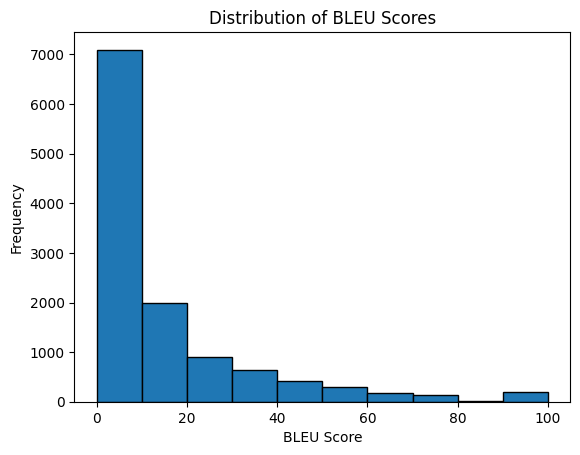

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt
bleu_scores = [score * 100 for score in bleu_scores]
print(sum(bleu_scores)/ len(bleu_scores))
plt.hist(bleu_scores, bins=10, edgecolor='black')
plt.title('Distribution of BLEU Scores')
plt.xlabel('BLEU Score')
plt.ylabel('Frequency')
plt.show()

# Below is the evaluations of BLEU score for random 500 samples.

In [ ]:
# Save list to a JSON file
with open('bleu_scores_over_test_set.json', 'w') as json_file:
    json.dump(bleu_scores, json_file)

# Load list from the JSON file
with open('bleu_scores_over_test_set.json', 'r') as json_file:
    loaded_list = json.load(json_file)
print(len(loaded_list))

10653


In [40]:
# NEW ONE

from nltk.tokenize import word_tokenize
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

# Load the generated content from the text file
with open('results/results-replace-bleu.txt', 'r', encoding='utf-8') as generated_file:
    generated_content = generated_file.readlines()

# # Load your test dataframe
# test_df = pd.read_csv('your_test_data.csv')

# Character replacement mapping (if needed)
# replacement_mapping = {
#     '\u2013': '\u002d',  # Replace en dash with hyphen-minus
#     # Add more replacement mappings as needed
# }

# BLEU scores lists to store scores for each data item
bleu1_scores = []
bleu2_scores = []
bleu3_scores = []
bleu4_scores = []

# Smoothing function for BLEU score calculation
smoothing_function = SmoothingFunction().method4

# Iterate through the test dataframe
for index, row in test_df.iterrows():
    # Assuming the generated content is in the format "generated_answer<sep>generated_question"
    generated_pair = generated_content[index].strip().split('<sep>')

    # Extract generated answer and question
    generated_answer = generated_pair[0]
    generated_question = generated_pair[1]

    # Optionally, perform character replacements (if needed)
    # generated_question = generated_question.translate(str.maketrans(replacement_mapping))

    # Tokenize reference and generated sequences
    # reference_tokens = row['question'].split()  # Assuming questions are already tokenized
    # generated_tokens = generated_question.split()


    # Optionally, perform character replacements (if needed)
    # generated_question = generated_question.translate(str.maketrans(replacement_mapping))

    # Tokenize reference and generated sequences
    reference_tokens = word_tokenize(row['question'])  # Assuming questions are not tokenized
    generated_tokens = word_tokenize(generated_question)  # Tokenizing the generated question




    # Extract generated answer and question


    # Optionally, perform character replacements (if needed)
    # generated_question = generated_question.translate(str.maketrans(replacement_mapping))

    # Tokenize reference and generated sequences




    # Calculate BLEU scores for different n-grams
    bleu1_score = sentence_bleu([reference_tokens], generated_tokens, weights=(1, 0, 0, 0), smoothing_function=smoothing_function)
    bleu2_score = sentence_bleu([reference_tokens], generated_tokens, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothing_function)
    bleu3_score = sentence_bleu([reference_tokens], generated_tokens, weights=(0.33, 0.33, 0.33, 0), smoothing_function=smoothing_function)
    bleu4_score = sentence_bleu([reference_tokens], generated_tokens, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothing_function)

    # Append the BLEU scores to the lists
    bleu1_scores.append(bleu1_score)
    bleu2_scores.append(bleu2_score)
    bleu3_scores.append(bleu3_score)
    bleu4_scores.append(bleu4_score)

# Now, 'bleu1_scores', 'bleu2_scores', 'bleu3_scores', and 'bleu4_scores' contain the BLEU scores for each data item in your test set
print("BLEU-1 Scores:", bleu1_scores)
print("BLEU-2 Scores:", bleu2_scores)
print("BLEU-3 Scores:", bleu3_scores)
print("BLEU-4 Scores:", bleu4_scores)


BLEU-1 Scores: [0.2768365042534086, 0.48404410457807934, 0.36391839582758007, 0.5488116360940264, 0.23884377019126307, 0.3436446393954861, 0.48675048941962806, 0.36363636363636365, 0.36193496721438384, 0.13333333333333333, 0.6369167205100349, 0.6133629430862155, 0.5515605641153721, 0.2791881675133095, 0.375, 0.6717807104613434, 0.4014460713892427, 0.30750686984807074, 0.6666666666666666, 0.388241882763772, 0.3888888888888889, 0.38461538461538464, 0.23076923076923078, 0.4616264865020232, 0.043932856352621126, 0.5054422164271946, 0.5573021304462805, 0.2596002610238016, 0.36642584206982365, 0.19047619047619047, 0.26666666666666666, 0.7914497715327151, 0.5, 0.625, 0.49123845184678916, 0.6369167205100349, 0.354274914555761, 0.22744899739223753, 0.35227989855505343, 0.6640732482052818, 0.9200444146293233, 0.4523947572871905, 0.35270071870442254, 0.5687541232354464, 0.35826565528689464, 0.12750076016387393, 0.4179765978347104, 0.33516002301781966, 0.6666666666666666, 0.45489799478447507, 0.55

In [41]:
bleu1_scores = [score * 100 for score in bleu1_scores]
bleu2_scores = [score * 100 for score in bleu2_scores]
bleu3_scores = [score * 100 for score in bleu3_scores]
bleu4_scores = [score * 100 for score in bleu4_scores]

bleu1_avg = sum(bleu1_scores) / len(bleu1_scores)
bleu2_avg = sum(bleu2_scores) / len(bleu2_scores)
bleu3_avg = sum(bleu3_scores) / len(bleu3_scores)
bleu4_avg = sum(bleu4_scores) / len(bleu4_scores)
print(f'Bleu1: {bleu1_avg}, BLEU2: {bleu2_avg}, BLEU3: {bleu3_avg}, BLEU4: {bleu4_avg}')

Bleu1: 41.238535333653395, BLEU2: 27.07966577431129, BLEU3: 20.111647244743537, BLEU4: 15.20461471905159


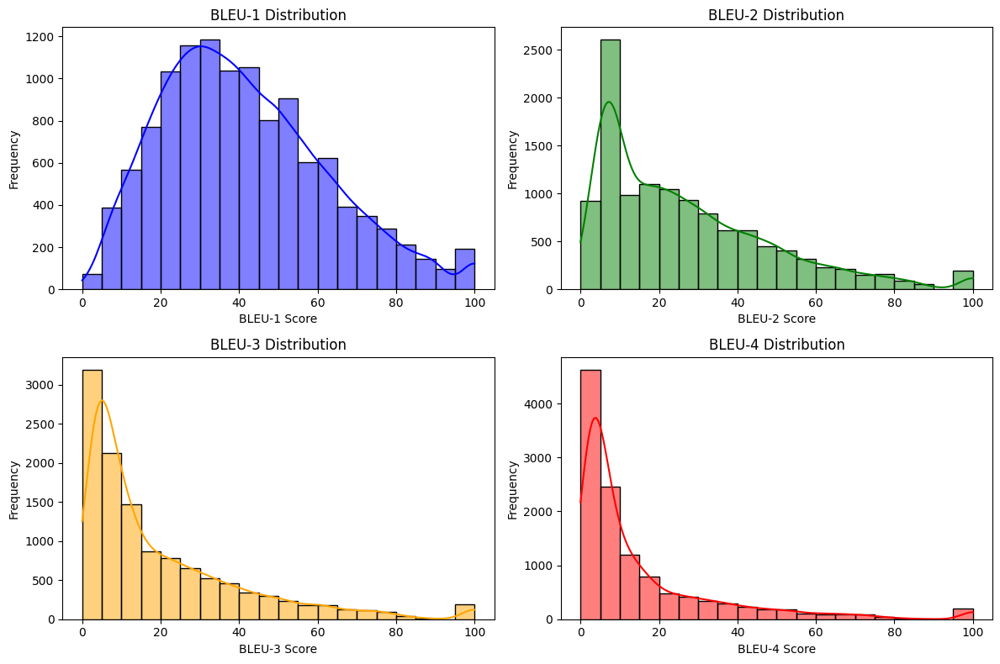

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have calculated bleu1_scores, bleu2_scores, bleu3_scores, and bleu4_scores

# Plot histograms with overlaid curves for BLEU-1, BLEU-2, BLEU-3, and BLEU-4 scores separately
plt.figure(figsize=(12, 8))

# Plot for BLEU-1
plt.subplot(2, 2, 1)
sns.histplot(bleu1_scores, bins=20, color='blue', kde=True)
plt.title('BLEU-1 Distribution')
plt.xlabel('BLEU-1 Score')
plt.ylabel('Frequency')

# Plot for BLEU-2
plt.subplot(2, 2, 2)
sns.histplot(bleu2_scores, bins=20, color='green', kde=True)
plt.title('BLEU-2 Distribution')
plt.xlabel('BLEU-2 Score')
plt.ylabel('Frequency')

# Plot for BLEU-3
plt.subplot(2, 2, 3)
sns.histplot(bleu3_scores, bins=20, color='orange', kde=True)
plt.title('BLEU-3 Distribution')
plt.xlabel('BLEU-3 Score')
plt.ylabel('Frequency')

# Plot for BLEU-4
plt.subplot(2, 2, 4)
sns.histplot(bleu4_scores, bins=20, color='red', kde=True)
plt.title('BLEU-4 Distribution')
plt.xlabel('BLEU-4 Score')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


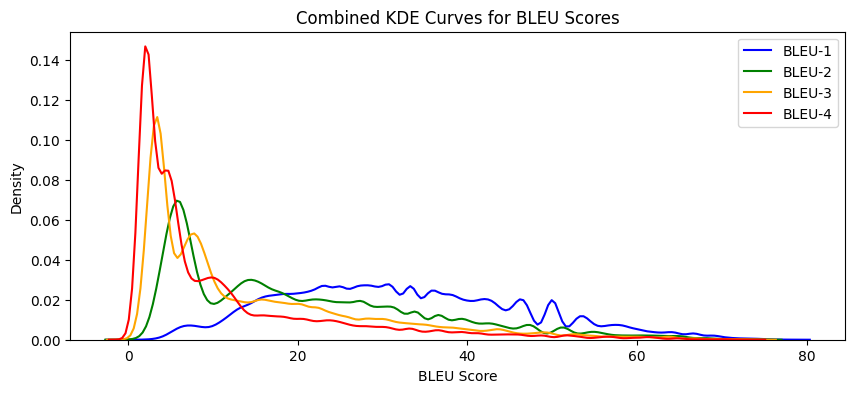

In [145]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have calculated bleu1_scores, bleu2_scores, bleu3_scores, and bleu4_scores

# Plot a single figure with combined KDE curves for BLEU-1, BLEU-2, BLEU-3, and BLEU-4 scores
plt.figure(figsize=(10, 4))

# Plot KDE curves for all BLEU scores
sns.kdeplot(bleu1_scores * 100, color='blue', label='BLEU-1', fill=False)
sns.kdeplot(bleu2_scores * 100, color='green', label='BLEU-2', fill=False)
sns.kdeplot(bleu3_scores * 100, color='orange', label='BLEU-3', fill=False)
sns.kdeplot(bleu4_scores * 100, color='red', label='BLEU-4', fill=False)

# Set plot title and labels
plt.title('Combined KDE Curves for BLEU Scores')
plt.xlabel('BLEU Score')
plt.ylabel('Density')

# Display legend
plt.legend()

plt.show()


/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:418: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


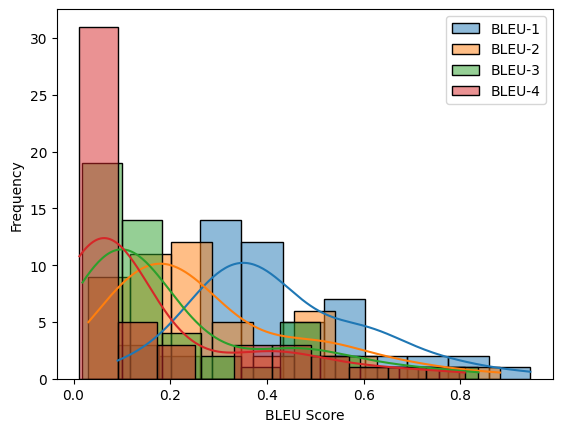

In [ ]:
# bleu_scores = []
bleu_1_scores = []
bleu_2_scores = []
bleu_3_scores = []
bleu_4_scores = []
random_subset = test_df.sample(n=50, random_state=42)
smoothing_function = SmoothingFunction()
for index, row in random_subset.iterrows():
    # Generate a question using your 'generate' function
    generated_question = generate(best_model, row['answer_text'], row['context'])

    # Tokenize reference and generated questions
    reference_question_tokens = word_tokenize(row['question'])
    generated_question_tokens = word_tokenize(generated_question)

    # Compute BLEU score for the pair
    # bleu_score = sentence_bleu([reference_question_tokens], generated_question_tokens, smoothing_function=smoothing_function.method4)

    bleu_1 = sentence_bleu([reference_question_tokens], generated_question_tokens, weights=(1.0, 0, 0, 0),
                            smoothing_function=smoothing_function.method4)
    bleu_2 = sentence_bleu([reference_question_tokens], generated_question_tokens, weights=(0.5, 0.5, 0, 0),
                            smoothing_function=smoothing_function.method4)
    bleu_3 = sentence_bleu([reference_question_tokens], generated_question_tokens, weights=(0.33, 0.33, 0.33, 0),
                            smoothing_function=smoothing_function.method4)
    bleu_4 = sentence_bleu([reference_question_tokens], generated_question_tokens, smoothing_function=smoothing_function.method4)

    # Append the BLEU scores to the respective lists
    bleu_1_scores.append(bleu_1)
    bleu_2_scores.append(bleu_2)
    bleu_3_scores.append(bleu_3)
    bleu_4_scores.append(bleu_4)

# Visualize BLEU scores using histograms
sns.histplot(bleu_1_scores, bins=10, kde=True, label='BLEU-1')
sns.histplot(bleu_2_scores, bins=10, kde=True, label='BLEU-2')
sns.histplot(bleu_3_scores, bins=10, kde=True, label='BLEU-3')
sns.histplot(bleu_4_scores, bins=10, kde=True, label='BLEU-4')

# Add labels and legend
plt.xlabel('BLEU Score')
plt.ylabel('Frequency')
plt.legend()

# Show the plot
plt.show()
    # Append the BLEU score to the list
    # bleu_scores.append(bleu_score)

# Now, 'bleu_scores' contains the BLEU score for each question in your test set
# print("BLEU Scores:", bleu_scores)

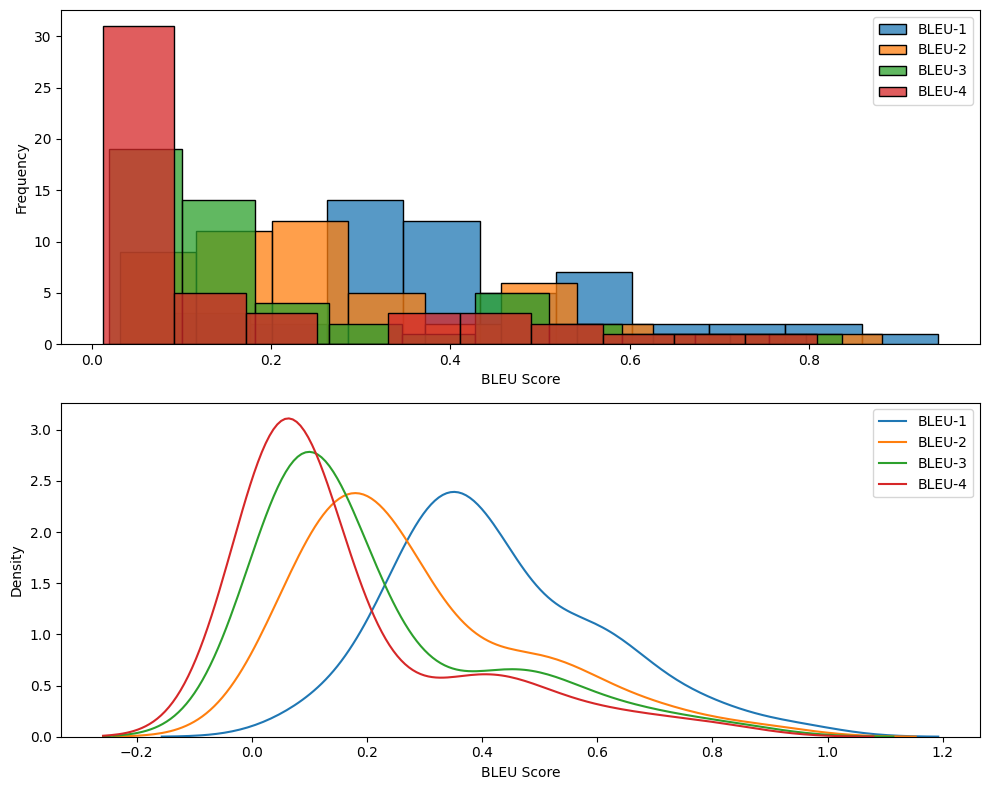

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming you have bleu_1_scores, bleu_2_scores, bleu_3_scores, and bleu_4_scores

# Create subplots with 2 rows and 1 column
fig, axes = plt.subplots(2, 1, figsize=(10, 8))

# Plot histograms in the first subplot
sns.histplot(bleu_1_scores, bins=10, kde=False, label='BLEU-1', ax=axes[0])
sns.histplot(bleu_2_scores, bins=10, kde=False, label='BLEU-2', ax=axes[0])
sns.histplot(bleu_3_scores, bins=10, kde=False, label='BLEU-3', ax=axes[0])
sns.histplot(bleu_4_scores, bins=10, kde=False, label='BLEU-4', ax=axes[0])
axes[0].set_xlabel('BLEU Score')
axes[0].set_ylabel('Frequency')
axes[0].legend()

# Plot KDE curves in the second subplot
sns.kdeplot(bleu_1_scores, label='BLEU-1', ax=axes[1])
sns.kdeplot(bleu_2_scores, label='BLEU-2', ax=axes[1])
sns.kdeplot(bleu_3_scores, label='BLEU-3', ax=axes[1])
sns.kdeplot(bleu_4_scores, label='BLEU-4', ax=axes[1])
axes[1].set_xlabel('BLEU Score')
axes[1].set_ylabel('Density')
axes[1].legend()

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


In [ ]:
print(sum(bleu_1_scores)/ len(bleu_1_scores))
print(sum(bleu_2_scores) / len(bleu_2_scores))
print(sum(bleu_3_scores) / len(bleu_3_scores))
print(sum(bleu_4_scores) / len(bleu_4_scores))

0.42691418896478156
0.2834581874191967
0.21121572072820466
0.16673371861332165


0.13396699106274096


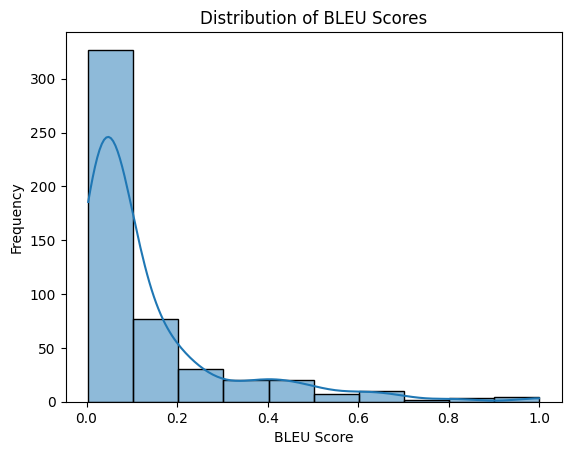

In [ ]:
# print(sum(bleu_scores)/ len(bleu_scores))
# # plt.hist(bleu_scores, bins=10, edgecolor='black')
# sns.histplot(bleu_scores, bins=10, kde=True)
# plt.title('Distribution of BLEU Scores')
# plt.xlabel('BLEU Score')
# plt.ylabel('Frequency')
# plt.show()

In [ ]:
print(len(test_df))

11877


In [ ]:
answer = "[MASK]"
context = '''
The healthcare industry has witnessed a transformative impact with the implementation of AI.
Machine learning algorithms analyze vast datasets to predict disease outbreaks, assist in early diagnosis,
 and recommend personalized treatment plans. AI-driven technologies are improving patient outcomes, reducing
 diagnostic errors, and revolutionizing the way medical professionals deliver care.

'''
generated = generate(best_model, answer, context)
print(generated)

What technology is helping healthcare industry?


In [43]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!pip install rouge

In [44]:
from rouge import Rouge

In [46]:
from rouge import Rouge

# Load the generated content from the text file
# Replace 'your_generated_data.txt' with the actual path to your generated data file
with open('results/results-replace-bleu.txt', 'r', encoding='utf-8') as generated_file:
    generated_content = generated_file.readlines()

# Load your test dataframe
# Replace 'your_test_data.csv' with the actual path to your test data file
# test_df = pd.read_csv('your_test_data.csv')

# Rouge scores list to store scores for each data item
rouge_scores = []

# Instantiate the Rouge object
rouge = Rouge()

# Iterate through the test dataframe
for index, row in test_df.iterrows():
    # Assuming the generated content is in the format "generated_answer<sep>generated_question"
    generated_pair = generated_content[index].strip().split('<sep>')

    # Extract generated answer and question
    generated_answer = generated_pair[0]
    generated_question = generated_pair[1]

    # Optionally, perform character replacements (if needed)
    # generated_question = generated_question.translate(str.maketrans(replacement_mapping))

    # Calculate ROUGE score for the pair
    rouge_score = rouge.get_scores(generated_question, row['question'])

    # Append the ROUGE score to the list
    rouge_scores.append(rouge_score)

# Now, 'rouge_scores' contains the ROUGE score for each data item in your test set
print("ROUGE Scores:", rouge_scores)


ROUGE Scores: [[{'rouge-1': {'r': 0.25, 'p': 0.3, 'f': 0.27272726776859507}, 'rouge-2': {'r': 0.16666666666666666, 'p': 0.2222222222222222, 'f': 0.19047618557823143}, 'rouge-l': {'r': 0.25, 'p': 0.3, 'f': 0.27272726776859507}}], [{'rouge-1': {'r': 0.5, 'p': 0.8333333333333334, 'f': 0.6249999953125001}, 'rouge-2': {'r': 0.2222222222222222, 'p': 0.4, 'f': 0.285714281122449}, 'rouge-l': {'r': 0.5, 'p': 0.8333333333333334, 'f': 0.6249999953125001}}], [{'rouge-1': {'r': 0.35714285714285715, 'p': 0.625, 'f': 0.4545454499173554}, 'rouge-2': {'r': 0.23076923076923078, 'p': 0.375, 'f': 0.28571428099773244}, 'rouge-l': {'r': 0.2857142857142857, 'p': 0.5, 'f': 0.36363635900826446}}], [{'rouge-1': {'r': 0.42857142857142855, 'p': 0.75, 'f': 0.5454545408264463}, 'rouge-2': {'r': 0.3333333333333333, 'p': 0.6666666666666666, 'f': 0.44444444000000005}, 'rouge-l': {'r': 0.42857142857142855, 'p': 0.75, 'f': 0.5454545408264463}}], [{'rouge-1': {'r': 0.18181818181818182, 'p': 0.2857142857142857, 'f': 0.222

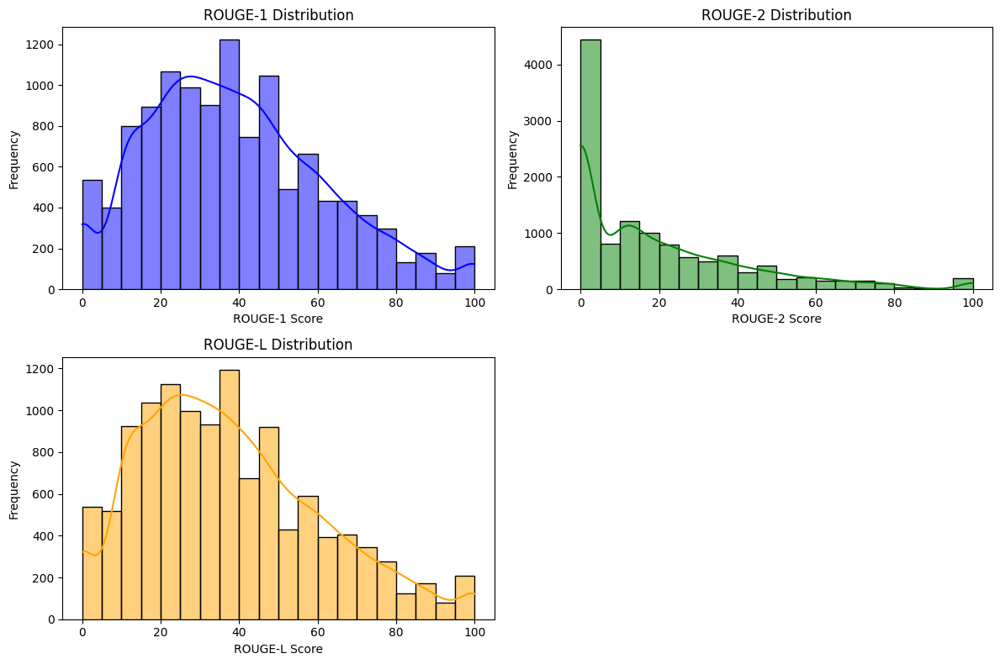

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have calculated rouge_scores
# Make sure to replace this with your actual list of ROUGE scores

# Extract ROUGE-1, ROUGE-2, and ROUGE-L scores from the list of dictionaries
rouge1_scores = [item[0]['rouge-1']['f'] * 100 for item in rouge_scores]
rouge2_scores = [item[0]['rouge-2']['f'] * 100 for item in rouge_scores]
rougel_scores = [item[0]['rouge-l']['f'] * 100 for item in rouge_scores]

# Plot histograms with overlaid curves for ROUGE-1, ROUGE-2, and ROUGE-L scores
plt.figure(figsize=(12, 8))

# Plot for ROUGE-1
plt.subplot(2, 2, 1)
sns.histplot(rouge1_scores, bins=20, color='blue', kde=True)
plt.title('ROUGE-1 Distribution')
plt.xlabel('ROUGE-1 Score')
plt.ylabel('Frequency')

# Plot for ROUGE-2
plt.subplot(2, 2, 2)
sns.histplot(rouge2_scores, bins=20, color='green', kde=True)
plt.title('ROUGE-2 Distribution')
plt.xlabel('ROUGE-2 Score')
plt.ylabel('Frequency')

# Plot for ROUGE-L
plt.subplot(2, 2, 3)
sns.histplot(rougel_scores, bins=20, color='orange', kde=True)
plt.title('ROUGE-L Distribution')
plt.xlabel('ROUGE-L Score')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


In [50]:
# Assuming you have calculated rouge_scores
# Make sure to replace this with your actual list of ROUGE scores

# Extract ROUGE-1, ROUGE-2, and ROUGE-L scores from the list of dictionaries
# rouge1_scores = [score['rouge-1']['f'] * 100 for score in rouge_scores]
# rouge2_scores = [score['rouge-2']['f'] * 100 for score in rouge_scores]
# rougel_scores = [score['rouge-l']['f'] * 100 for score in rouge_scores]

# Calculate overall ROUGE scores by averaging
overall_rouge1 = sum(rouge1_scores) / len(rouge1_scores)
overall_rouge2 = sum(rouge2_scores) / len(rouge2_scores)
overall_rougel = sum(rougel_scores) / len(rougel_scores)

# Print overall ROUGE scores
print("Overall ROUGE-1 Score (out of 100):", overall_rouge1)
print("Overall ROUGE-2 Score (out of 100):", overall_rouge2)
print("Overall ROUGE-L Score (out of 100):", overall_rougel)


Overall ROUGE-1 Score (out of 100): 39.13379520475133
Overall ROUGE-2 Score (out of 100): 19.562158493674808
Overall ROUGE-L Score (out of 100): 37.56148322521256


In [ ]:
def calculate_rouge(reference, candidate):
    rouge = Rouge()
    scores = rouge.get_scores(candidate, reference)
    return scores

rouge_scores = []
random_subset = test_df.sample(n=500, random_state=42)
for index, row in random_subset.iterrows():
    # Generate a question using your 'generate' function
    generated_question = generate(best_model, row['answer_text'], row['context'])

    # Tokenize reference and generated questions
    reference_question = row['question']
    rouge_scores.append(calculate_rouge(reference_question, generated_question))
print(rouge_scores)

/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:418: UserWarning: `num_beams` is set to 1. However, `early_stopping` is set to `True` -- this flag is only used in beam-based generation modes. You should set `num_beams>1` or unset `early_stopping`.
  warnings.warn(


[[{'rouge-1': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.0, 'p': 0.0, 'f': 0.0}}], [{'rouge-1': {'r': 0.4166666666666667, 'p': 0.625, 'f': 0.4999999952000001}, 'rouge-2': {'r': 0.25, 'p': 0.42857142857142855, 'f': 0.31578946903047095}, 'rouge-l': {'r': 0.4166666666666667, 'p': 0.625, 'f': 0.4999999952000001}}], [{'rouge-1': {'r': 0.1, 'p': 0.08333333333333333, 'f': 0.09090908595041348}, 'rouge-2': {'r': 0.0, 'p': 0.0, 'f': 0.0}, 'rouge-l': {'r': 0.1, 'p': 0.08333333333333333, 'f': 0.09090908595041348}}], [{'rouge-1': {'r': 0.5555555555555556, 'p': 0.625, 'f': 0.5882352891349482}, 'rouge-2': {'r': 0.25, 'p': 0.2857142857142857, 'f': 0.266666661688889}, 'rouge-l': {'r': 0.5555555555555556, 'p': 0.625, 'f': 0.5882352891349482}}], [{'rouge-1': {'r': 0.25, 'p': 0.2857142857142857, 'f': 0.266666661688889}, 'rouge-2': {'r': 0.14285714285714285, 'p': 0.16666666666666666, 'f': 0.1538461488757398}, 'rouge-l': {'r': 0.25, 'p': 0.2857142857142857,

0.3750818198701602, 0.1765315555515071, 0.3566236997640601


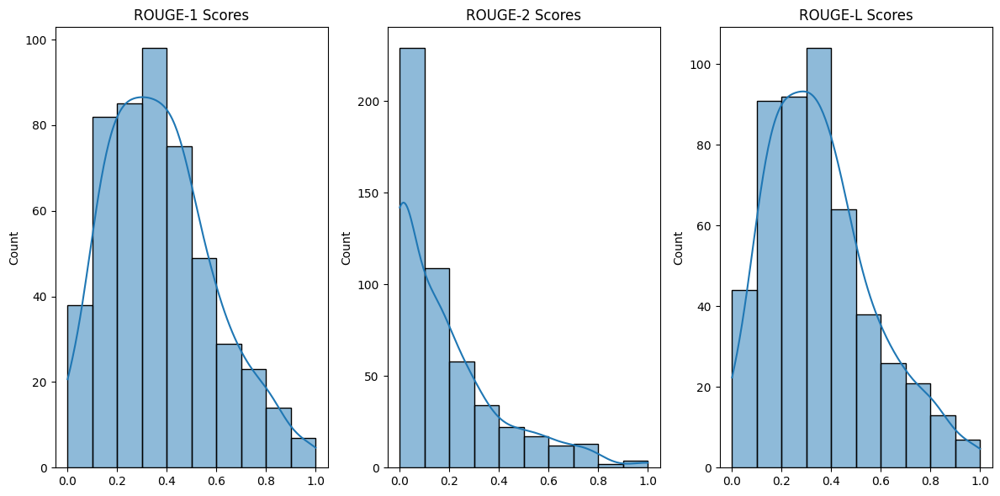

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Extracting ROUGE-1, ROUGE-2, and ROUGE-L scores for each example
rouge_1_scores = []
rouge_2_scores = []
rouge_l_scores = []

for scores in rouge_scores:
    rouge_1_scores.append(scores[0]['rouge-1']['f'])
    rouge_2_scores.append(scores[0]['rouge-2']['f'])
    rouge_l_scores.append(scores[0]['rouge-l']['f'])

avg_r1 = sum(rouge_1_scores) / len(rouge_1_scores)
avg_r2 = sum(rouge_2_scores) / len(rouge_2_scores)
avg_rl = sum(rouge_l_scores) / len(rouge_l_scores)
print(f"{avg_r1}, {avg_r2}, {avg_rl}")

# Plotting histograms for ROUGE scores
plt.figure(figsize=(12, 6))

# ROUGE-1 histogram
plt.subplot(1, 3, 1)
sns.histplot(rouge_1_scores, bins=10, kde=True)
plt.title('ROUGE-1 Scores')

# ROUGE-2 histogram
plt.subplot(1, 3, 2)
sns.histplot(rouge_2_scores, bins=10, kde=True)
plt.title('ROUGE-2 Scores')

# ROUGE-L histogram
plt.subplot(1, 3, 3)
sns.histplot(rouge_l_scores, bins=10, kde=True)
plt.title('ROUGE-L Scores')

plt.tight_layout()
plt.show()
